In [1]:
import matplotlib.pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages
from matplotlib.colors import ListedColormap
import matplotlib.ticker as ticker
import matplotlib.pyplot as plt
import pandas as pd
from matplotlib.ticker import MaxNLocator
import seaborn as sns
import os
import gzip
import numpy as np
import scanpy as sc
import squidpy as sq
import cupy as cp
import cupyx
from cupyx.scipy.sparse import csr_matrix 
import os
import time
import rapids_singlecell as rsc
import numpy as np
import rmm
from rmm.allocators.cupy import rmm_cupy_allocator
import cupy

rmm.reinitialize(
    managed_memory=False,  # Allows oversubscription
    pool_allocator=False,  # default is False
    devices=0,  # GPU device IDs to register. By default registers only GPU 0.
)
cp.cuda.set_allocator(rmm_cupy_allocator)
import zarr
import pickle
from collections import OrderedDict
from scipy.sparse import csr_matrix
import pandas as pd
import scipy.stats as stats
from statsmodels.stats.multitest import multipletests
from scipy.sparse import csr_matrix
import scipy
import anndata
from collections import OrderedDict
from rsc_functions.utility.applyqc import applyqc
from rsc_functions.reports.plot import plot_spatial,plot_spatial_data, plot_dist
from rsc_functions.utility.rank_genes_groups import return_markers,rank_genes_groups
from rsc_functions.reports.plot import plot_expression

In [2]:
path_016 = "/data/kanferg/Sptial_Omics/playGround/Data/Visium_HD_Human_Colon_Cancer_binned_outputs/binned_outputs/square_016um"
pathout = "/data/kanferg/Sptial_Omics/SpatialOmicsToolkit/out_2"

In [3]:
def parquet_to_csv(path):
    '''
    Converts a Parquet file to a CSV file if the CSV file does not already exist.
    '''
    file_path = os.path.join(path,'spatial/tissue_positions_list.csv')
    if not os.path.exists(file_path):
        df = pd.read_parquet(os.path.join(path,'spatial/tissue_positions.parquet'))
        # Write to a CSV file
        df.to_csv(os.path.join(path,'spatial/tissue_positions_list.csv'), index=False)
    return
parquet_to_csv(path_016)

In [4]:
andata = sc.read_visium(path=path_016)
rsc.get.anndata_to_GPU(andata)
andata.obsm['spatial'] = np.array(andata.obsm['spatial'], dtype=np.float64)
andata.var_names_make_unique()
andata.uns['config'] = OrderedDict()
andata.uns["config"]["secondary_var_names"] = andata.var_names
rsc.pp.flag_gene_family(andata, gene_family_name="MT", gene_family_prefix="MT-")
rsc.pp.calculate_qc_metrics(andata, qc_vars=["MT"])

/usr/local/apps/rapids-singlecell/mamba/envs/rapids_singlecell/lib/python3.11/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/usr/local/apps/rapids-singlecell/mamba/envs/rapids_singlecell/lib/python3.11/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/usr/local/apps/rapids-singlecell/mamba/envs/rapids_singlecell/lib/python3.11/site-packages/scanpy/readwrite.py:476: DtypeWarning: Columns (1,2,3,4,5) have mixed types. Specify dtype option on import or set low_memory=False.
  positions = pd.read_csv(


In [5]:
andata

AnnData object with n_obs × n_vars = 137051 × 18085
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'total_counts', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'total_counts_MT', 'pct_counts_MT', 'log1p_total_counts_MT'
    var: 'gene_ids', 'feature_types', 'genome', 'MT', 'n_cells_by_counts', 'total_counts', 'mean_counts', 'pct_dropout_by_counts', 'log1p_total_counts', 'log1p_mean_counts'
    uns: 'spatial', 'config'
    obsm: 'spatial'

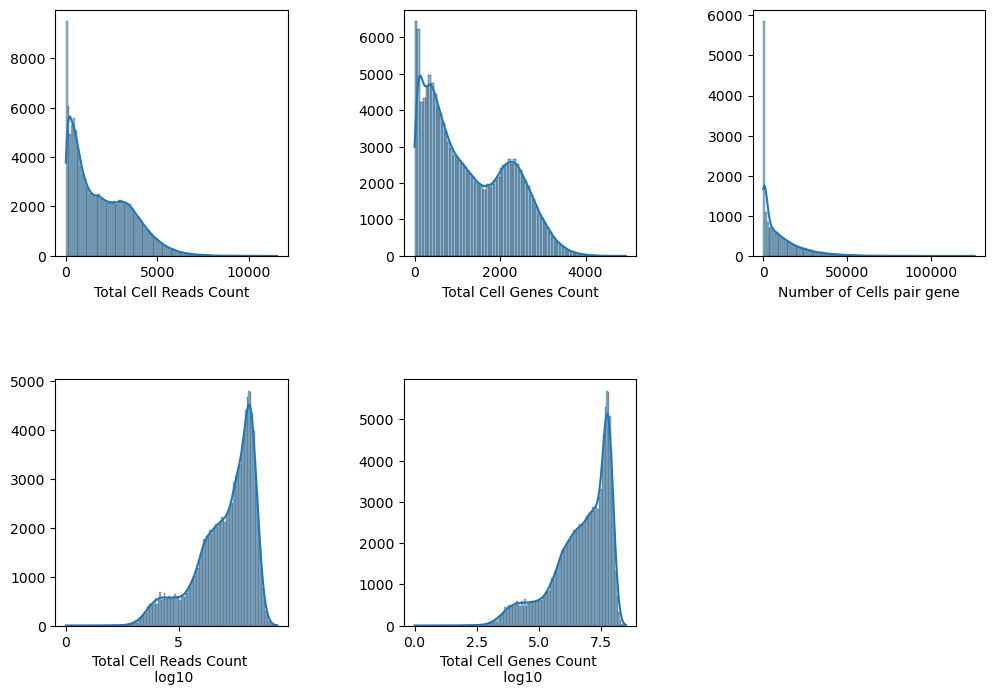

In [6]:
import warnings
# Suppress warnings in this specific code chunk
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    fig, ax = plt.subplots(2, 3, figsize=(12, 8))
    ax = np.ravel(ax)
    plot_dist(andata,column = 'total_counts',ax = ax[0],xlab = 'Total Cell Reads Count')
    plot_dist(andata,column = 'n_genes_by_counts',ax = ax[1],xlab = 'Total Cell Genes Count')
    plot_dist(andata,column = 'n_cells_by_counts',bins = 'doane', type = 'var', ax = ax[2],xlab = 'Number of Cells pair gene')
    plot_dist(andata,column = 'log1p_total_counts',ax = ax[3],xlab = 'Total Cell Reads Count \n log10')
    plot_dist(andata,column = 'log1p_n_genes_by_counts',ax = ax[4],xlab = 'Total Cell Genes Count \n log10')
    ax[5].axis('off')
    plt.subplots_adjust(wspace = 0.5, hspace=0.5)

In [7]:
plt.rcParams['figure.dpi'] = 600
plt.rcParams['font.family'] = ['serif']
plt.rcParams['font.size'] = 12
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['axes.titlesize'] = 12
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
fig, ax = plt.subplots(1,1, figsize=(15, 15))
with PdfPages(os.path.join(pathout, 'Report_spatial_map_plot_Colon_total_count.pdf')) as pdf:
    plot_spatial_data(andata, 'total_counts', fig = fig , ax = ax ,set_xlabel_cbar = 'Total Count',size = 1)
    plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.2)
    pdf.savefig()
    plt.close()   

In [8]:
rsc.pp.filter_cells(andata, min_count=50,qc_var = 'total_counts')
rsc.pp.filter_genes(andata, min_count=50)
rsc.pp.filter_genes(andata, max_count=50_000)
andata.layers['counts'] = andata.X.copy()
rsc.pp.normalize_total(andata)
rsc.pp.log1p(andata)
andata.layers['log'] = andata.X.copy()
rsc.pp.highly_variable_genes(andata, n_top_genes=1500, flavor="seurat_v3", layer="log")
andata = andata[:, andata.var["highly_variable"]]
rsc.pp.scale(andata, max_value=10)
rsc.pp.pca(andata, n_comps=30,random_state=1337, use_highly_variable=False)

filtered out 3769 cells
filtered out 1143 genes based on n_cells_by_counts
filtered out 253 genes based on n_cells_by_counts


/usr/local/apps/rapids-singlecell/mamba/envs/rapids_singlecell/lib/python3.11/site-packages/rapids_singlecell/preprocessing/_hvg.py:517: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(
/usr/local/apps/rapids-singlecell/mamba/envs/rapids_singlecell/lib/python3.11/site-packages/rapids_singlecell/preprocessing/_scale.py:71: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/usr/local/apps/rapids-singlecell/mamba/envs/rapids_singlecell/lib/python3.11/site-packages/scanpy/preprocessing/_pca.py:374: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


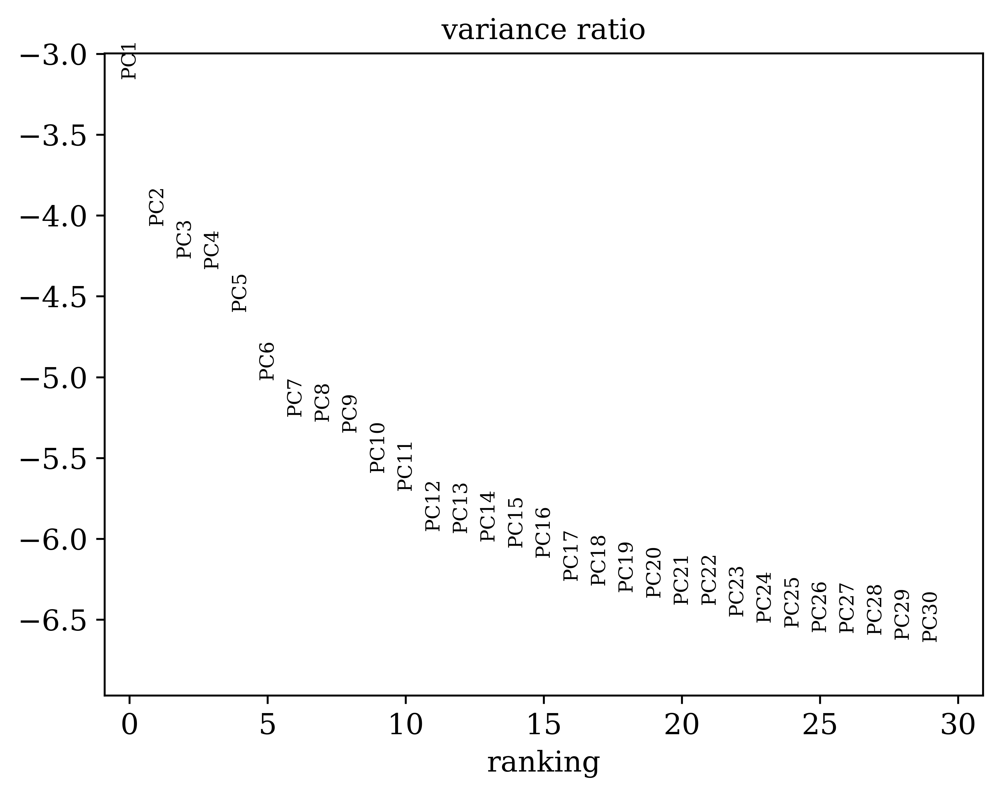

In [9]:
sc.pl.pca_variance_ratio(andata, log=True, n_pcs=30)

In [10]:
rsc.pp.neighbors(andata, n_pcs=15, use_rep='X_pca', n_neighbors=25)
rsc.tl.leiden(andata, random_state=1337, resolution=0.5, key_added='cluster') 

In [11]:
fig, ax = plt.subplots(1, 1, figsize=(15,15))
plt.rcParams['figure.dpi'] = 800
plt.rcParams['font.family'] = ['serif']
plt.rcParams['font.size'] = 12
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['axes.titlesize'] = 12
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
clusterColorMap = plot_spatial(andata,ax = ax, features = None, title = '',markerscale = 5, xlab = '',ylab ='',size = 1,random_palette = True)
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.2)

In [12]:
from matplotlib.backends.backend_pdf import PdfPages
with PdfPages(os.path.join(pathout, 'Report_spatial_map_plot_Colon.pdf')) as pdf:
    fig, ax = plt.subplots(1, 1, figsize=(15,15))
    plt.rcParams['figure.dpi'] = 800
    plt.rcParams['font.family'] = ['serif']
    plt.rcParams['font.size'] = 12
    plt.rcParams['axes.labelsize'] = 12
    plt.rcParams['axes.titlesize'] = 12
    plt.rcParams['xtick.labelsize'] = 12
    plt.rcParams['ytick.labelsize'] = 12
    clusterColorMap = plot_spatial(andata,ax = ax, features = None, title = '',markerscale = 5, xlab = '',ylab ='',size = 1,random_palette = True)
    plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.2)
    pdf.savefig()
    plt.close()

In [13]:
andata.uns['clusterColorMap'] = clusterColorMap

In [14]:
andata.X = andata.layers['log'].copy()
rsc.get.anndata_to_CPU(andata)
sc.tl.rank_genes_groups(andata, groupby="cluster", method="wilcoxon")

In [15]:
fig, ax = plt.subplots(1, 1, figsize=(15,15))
plt.rcParams['figure.dpi'] = 300
plt.rcParams['font.family'] = ['serif']
plt.rcParams['font.size'] = 12
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['axes.titlesize'] = 12
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
sc.pl.rank_genes_groups_dotplot(andata, groupby="cluster",n_genes=2,values_to_plot = 'scores',ax =ax)
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.2)

<Figure size 1920x1440 with 0 Axes>

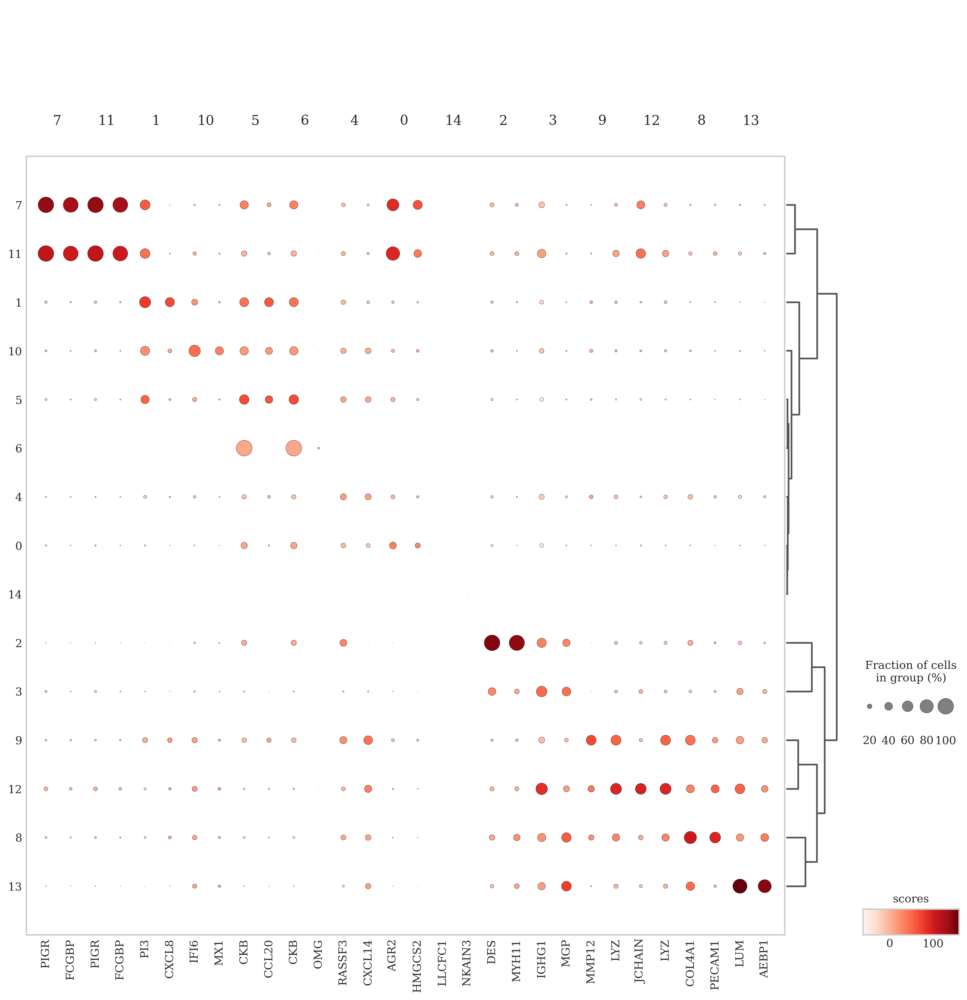

In [16]:
with PdfPages(os.path.join(pathout, 'dendrogram_colon.pdf')) as pdf:
    fig, ax = plt.subplots(1, 1, figsize=(15,15))
    plt.rcParams['figure.dpi'] = 300
    plt.rcParams['font.family'] = ['serif']
    plt.rcParams['font.size'] = 12
    plt.rcParams['axes.labelsize'] = 12
    plt.rcParams['axes.titlesize'] = 12
    plt.rcParams['xtick.labelsize'] = 12
    plt.rcParams['ytick.labelsize'] = 12
    sc.pl.rank_genes_groups_dotplot(andata, groupby="cluster",n_genes=2,values_to_plot = 'scores',ax =ax)
    plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.2)
    pdf.savefig()
    plt.close()

In [17]:
import squidpy as sq
sq.gr.spatial_neighbors(andata, coord_type="generic",delaunay = True)
sq.gr.nhood_enrichment(andata, cluster_key="cluster")

/usr/local/apps/rapids-singlecell/mamba/envs/rapids_singlecell/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
100%|████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:10<00:00, 98.08/s]


In [18]:
from matplotlib.colors import LinearSegmentedColormap
with PdfPages(os.path.join(pathout, 'nhood_enrichment_colon.pdf')) as pdf:
    colors = [(0, 0, 1), (1, 1, 1), (1, 0, 0)]  # Blue -> White -> Red
    n_bins = 100  # Discretize into 100 bins
    custom_cmap = LinearSegmentedColormap.from_list('custom_cmap', colors, N=n_bins)
    
    plt.rcParams['figure.dpi'] = 92
    plt.rcParams['font.family'] = ['serif']
    plt.rcParams['font.size'] = 12
    plt.rcParams['axes.labelsize'] = 12
    plt.rcParams['axes.titlesize'] = 12
    plt.rcParams['xtick.labelsize'] = 12
    plt.rcParams['ytick.labelsize'] = 12
    
    sq.pl.nhood_enrichment(
        andata,
        title = "Neighborhood Enrichment generic",
        cluster_key="cluster",
        method="average",
        cmap=custom_cmap,
        vmin=-200,
        vmax=200,
        figsize=(5, 5),
    )
    plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.2)
    pdf.savefig()
    plt.close()

/usr/local/apps/rapids-singlecell/mamba/envs/rapids_singlecell/lib/python3.11/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/usr/local/apps/rapids-singlecell/mamba/envs/rapids_singlecell/lib/python3.11/site-packages/squidpy/pl/_utils.py:555: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  row_labels = adata.obs[key][row_order]
/tmp/ipykernel_170617/952633860.py:25: UserWarning: This figure was using a layout engine that is incompatible with subplots_adjust and/or tight_layout; not calling subplots_adjust.
  plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.2)


In [19]:
from cupyx.scipy.sparse import csr_matrix
def save_matrix(matrix,pathout,file_name = "obsp_distances_large.npz"):
    cp.savez(os.path.join(pathout, file_name),  
            data=matrix.data,  
            indices=matrix.indices,  
            indptr=matrix.indptr,  
            shape=matrix.shape)
sparse_matrix = andata.obsp['distances']
save_matrix(matrix = sparse_matrix,pathout = pathout,file_name = "obsp_distances_large_colon.npz")
sparse_matrix = andata.obsp['connectivities']
save_matrix(matrix = sparse_matrix,pathout = pathout,file_name = "obsp_connectivities_large_colon.npz")

In [20]:
import pickle
with open(os.path.join(pathout,"andata_uns_mtracies__colon.pkl"), 'wb') as buff:
     pickle.dump({'config':andata.uns['config'], 'rank_genes_groups':andata.uns['rank_genes_groups'], 'clusterColorMap':andata.uns['clusterColorMap']}, buff)

In [21]:
andata

AnnData object with n_obs × n_vars = 133282 × 1500
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'total_counts', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'total_counts_MT', 'pct_counts_MT', 'log1p_total_counts_MT', 'cluster'
    var: 'gene_ids', 'feature_types', 'genome', 'MT', 'n_cells_by_counts', 'total_counts', 'mean_counts', 'pct_dropout_by_counts', 'log1p_total_counts', 'log1p_mean_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'spatial', 'config', 'log1p', 'hvg', 'pca', 'neighbors', 'leiden', 'clusterColorMap', 'rank_genes_groups', 'dendrogram_cluster', 'spatial_neighbors', 'cluster_nhood_enrichment'
    obsm: 'spatial', 'X_pca'
    varm: 'PCs'
    layers: 'counts', 'log'
    obsp: 'distances', 'connectivities', 'spatial_connectivities', 'spatial_distances'

In [22]:
andata_save = andata.copy()
for column in andata_save.obs.columns:
    print(f"Column '{column}' has data type: {andata_save.obs[column].dtype}")

Column 'in_tissue' has data type: object
Column 'array_row' has data type: object
Column 'array_col' has data type: object
Column 'n_genes_by_counts' has data type: int32
Column 'total_counts' has data type: float32
Column 'log1p_n_genes_by_counts' has data type: float64
Column 'log1p_total_counts' has data type: float32
Column 'total_counts_MT' has data type: float32
Column 'pct_counts_MT' has data type: float32
Column 'log1p_total_counts_MT' has data type: float32
Column 'cluster' has data type: category


In [23]:
andata_save = andata.copy()
# andata_save.X = andata_save.layers['log']
del andata_save.uns
# del andata_save.obsm
del andata_save.varm
# del andata_save.layers
del andata_save.obsp
del andata_save.obs['in_tissue']
del andata_save.obs['array_row']
del andata_save.obs['array_col']
andata_save.write_h5ad(os.path.join(pathout, "andata_save_colon.h5ad"))

<center>stlearn

In [1]:
import cupy as cp
import cupyx
import scanpy as sc
import stlearn as st
import scanpy as sc
import numpy as np
from cupyx.scipy.sparse import csr_matrix
import os
from PIL import Image
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from matplotlib.colors import LinearSegmentedColormap
from matplotlib.backends.backend_pdf import PdfPages
import seaborn as sns
import random
import pandas as pd

/gpfs/gsfs10/users/kanferg/conda/envs/stlearn-env/lib/python3.8/site-packages/stlearn/tools/microenv/cci/het.py:192: NumbaDeprecationWarning: The keyword argument 'nopython=False' was supplied. From Numba 0.59.0 the default is being changed to True and use of 'nopython=False' will raise a warning as the argument will have no effect. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @jit(parallel=True, nopython=False)


In [2]:
path_016 = "/data/kanferg/Sptial_Omics/playGround/Data/Visium_HD_Human_Colon_Cancer_binned_outputs/binned_outputs/square_016um"
pathout = "/data/kanferg/Sptial_Omics/SpatialOmicsToolkit/out_2"
andata = sc.read_h5ad(os.path.join(pathout, "andata_save_colon.h5ad"))
def load_matrix(andata,pathout,npz_file = "obsp_distances.npz",mode = 'sparse', mat_name = 'distances'):
    npzfile = cp.load(os.path.join(pathout, npz_file))
    data = cp.array(npzfile['data'])
    indices = cp.array(npzfile['indices'])
    indptr = cp.array(npzfile['indptr'])
    shape = tuple(npzfile['shape'])
    
    # Reconstruct the sparse matrix
    sparse_matrix_distances = csr_matrix((data, indices, indptr), shape=shape)
    if mode== 'sparse':
        andata.obsp[mat_name] = sparse_matrix_distances
    else:
        andata.obsp[mat_name] = sparse_matrix_distances.get()
    return andata

In [3]:
andata.obs["imagerow"] = andata.obsm['spatial'][:,0]
andata.obs["imagecol"] = andata.obsm['spatial'][:,1]
andata.uns["spatial"] = andata.obsm["spatial"]
def make_uns_spatial(adata):
    #max_size = np.max([adata.obs["imagerow"].max(), adata.obs["imagecol"].max()])
    #max_size = int(max_size + 0.1 * max_size)
    #image = Image.new("RGBA", (max_size, max_size), (255, 255, 255, 255))
    #imgarr = np.array(image)
    adata.uns["spatial"] = {}
    adata.uns["spatial"]["id1"] = {}
    #adata.uns["spatial"]["id1"]["images"] = {}
    #adata.uns["spatial"]["id1"]["images"]["lowres"] = imgarr
    adata.uns["spatial"]["id1"]["use_quality"] = "lowres"
    adata.uns["spatial"]["id1"]["scalefactors"] = {}
    adata.uns["spatial"]["id1"]["scalefactors"]["tissue_low_scalef" ] = 1
    adata.uns["spatial"]["id1"]["scalefactors"]["spot_diameter_fullres"] = 15
    adata.uns["spatial"]["id1"]["scalefactors"][
            "tissue_" + "lowres" + "_scalef"
        ] = 1
    return adata
andata = make_uns_spatial(andata)

In [4]:
andata = load_matrix(andata,pathout,npz_file = "obsp_distances_large_colon.npz",mode = 'sparse', mat_name = 'distances')
andata = load_matrix(andata,pathout,npz_file = "obsp_connectivities_large_colon.npz",mode = 'sparse', mat_name = 'connectivities')

In [5]:
import os
import pickle

file_path = os.path.join(pathout, "andata_uns_mtracies__colon.pkl")

if os.path.getsize(file_path) > 0:
    with open(file_path, 'rb') as buff:
        andata_uns_mtracies = pickle.load(buff)
else:
    print("File is empty. Cannot load data.")
    andata_uns_mtracies = None
andata.uns["spatial"] = andata.obsm["spatial"]
andata.uns['clusterColorMap'] = andata_uns_mtracies['clusterColorMap']
andata.obs["imagerow"] = andata.obsm['spatial'][:,0]
andata.obs["imagecol"] = andata.obsm['spatial'][:,1]
andata.uns["spatial"] = andata.obsm["spatial"]

In [6]:
andata

AnnData object with n_obs × n_vars = 133282 × 1500
    obs: 'n_genes_by_counts', 'total_counts', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'total_counts_MT', 'pct_counts_MT', 'log1p_total_counts_MT', 'cluster', 'imagerow', 'imagecol'
    var: 'gene_ids', 'feature_types', 'genome', 'MT', 'n_cells_by_counts', 'total_counts', 'mean_counts', 'pct_dropout_by_counts', 'log1p_total_counts', 'log1p_mean_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'spatial', 'clusterColorMap'
    obsm: 'X_pca', 'spatial'
    layers: 'counts', 'log'
    obsp: 'distances', 'connectivities'

In [7]:
andata.X =andata.layers['counts'].copy()

In [8]:
# Loading the LR databases available within stlearn (from NATMI)
lrs = st.tl.cci.load_lrs(['connectomeDB2020_lit'], species='human')
print(len(lrs))

2293


In [9]:
st.tl.cci.run(andata, lrs,
                  min_spots = 20, #Filter out any LR pairs with no scores for less than min_spots
                  distance=0, # None defaults to spot+immediate neighbours; distance=0 for within-spot mode
                  n_pairs=10000, # Number of random pairs to generate; low as example, recommend ~10,000
                  n_cpus=None, # Number of CPUs for parallel. If None, detects & use all available.
                  )

Calculating neighbours...
0 spots with no neighbours, 1 median spot neighbours.
Spot neighbour indices stored in adata.obsm['spot_neighbours'] & adata.obsm['spot_neigh_bcs'].
Altogether 184 valid L-R pairs


Generating backgrounds & testing each LR pair...: 100%|███████████████████████████████████████████████ [ time left: 00:00 ]



Storing results:

lr_scores stored in adata.obsm['lr_scores'].
p_vals stored in adata.obsm['p_vals'].
p_adjs stored in adata.obsm['p_adjs'].
-log10(p_adjs) stored in adata.obsm['-log10(p_adjs)'].
lr_sig_scores stored in adata.obsm['lr_sig_scores'].

Per-spot results in adata.obsm have columns in same order as rows in adata.uns['lr_summary'].
Summary of LR results in adata.uns['lr_summary'].


In [10]:
andata.uns['lr_summary']

,n_spots,n_spots_sig,n_spots_sig_pval
MCAM_MCAM,12299,10103,10750
MUC2_AGR2,8426,8371,8386
COL4A1_ITGA1,9004,7496,8031
PTPRM_PTPRM,6339,5926,6308
CCN2_LRP1,7308,5720,6179
...,...,...,...
ANGPTL1_TEK,26,26,26
IL16_KCNJ15,26,26,26
VWF_ITGA2B,24,24,24
NTRK3_PTPRS,21,21,21


In [11]:
andata

AnnData object with n_obs × n_vars = 133282 × 1500
    obs: 'n_genes_by_counts', 'total_counts', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'total_counts_MT', 'pct_counts_MT', 'log1p_total_counts_MT', 'cluster', 'imagerow', 'imagecol'
    var: 'gene_ids', 'feature_types', 'genome', 'MT', 'n_cells_by_counts', 'total_counts', 'mean_counts', 'pct_dropout_by_counts', 'log1p_total_counts', 'log1p_mean_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'spatial', 'clusterColorMap', 'lrfeatures', 'lr_summary'
    obsm: 'X_pca', 'spatial', 'spot_neighbours', 'spot_neigh_bcs', 'lr_scores', 'p_vals', 'p_adjs', '-log10(p_adjs)', 'lr_sig_scores'
    layers: 'counts', 'log'
    obsp: 'distances', 'connectivities'

In [12]:
import pickle
with open(os.path.join(pathout,"stlearn_uns_mtracies_colon.pkl"), 'wb') as buff:
     pickle.dump({'lrfeatures':andata.uns['lrfeatures'], 'lr_summary':andata.uns['lr_summary']}, buff)

In [13]:
andata.obsm['lr_scores'].shape

(133282, 184)

In [14]:
import pickle
with open(os.path.join(pathout,"stlearn_obsm_mtracies_colon.pkl"), 'wb') as buff:
     pickle.dump({'spot_neighbours':andata.obsm['spot_neighbours'], 'spot_neigh_bcs':andata.obsm['spot_neigh_bcs'],
                 'lr_scores':andata.obsm['lr_scores'], 'p_vals':andata.obsm['p_vals'],
                  '-log10(p_adjs)':andata.obsm['-log10(p_adjs)'], 'lr_sig_scores':andata.obsm['lr_sig_scores']
                 }, buff)

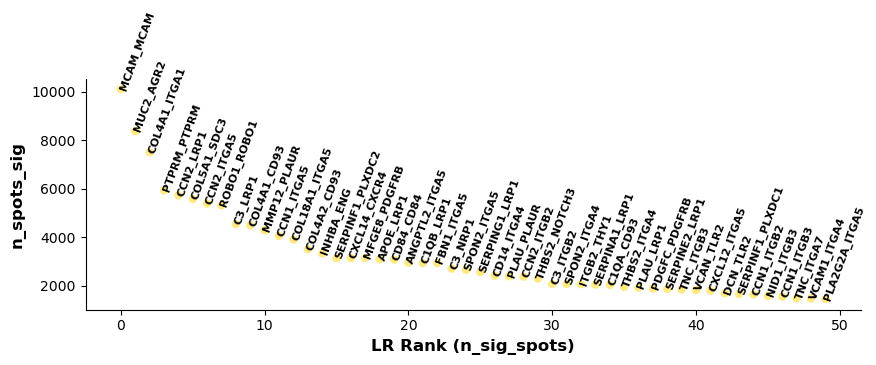

In [15]:
st.pl.lr_summary(andata, n_top=50, figsize=(10,3))

<center>voyagerpy</center>

In this section we will upload the distance and connectivity map results from  rapids-single-cell module. 
One of the big problem is working with sparse matrix from cupyx as alternative to regulate scipy.sparse csr_matrix. 
CuPy sparse matrices to SciPy:
```python
andata.obsp[mat_name] = sparse_matrix_distances.get()
```
SciPy sparse matrices to CuPy:
```python
from cupyx.scipy.sparse import csr_matrix
andata_sub.obsp['distances'] = csr_matrix(andata_sub.obsp['distances'])
andata_sub.obsp['distances'] = csr_matrix(andata_sub.obsp['connectivities'])
```


In [1]:
import cupy as cp
import cupyx
import scanpy as sc
import scanpy as sc
import numpy as np
from cupyx.scipy.sparse import csr_matrix
import os
from PIL import Image
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from matplotlib.colors import LinearSegmentedColormap
from matplotlib.backends.backend_pdf import PdfPages
import seaborn as sns
import random
import pandas as pd
import voyagerpy as vp
import geopandas as gpd
import libpysal as lps
from collections import OrderedDict
import scipy.sparse as sp
import pickle

In [2]:
path_016 = "/data/kanferg/Sptial_Omics/playGround/Data/Visium_HD_Human_Colon_Cancer_binned_outputs/binned_outputs/square_016um"
pathout = "/data/kanferg/Sptial_Omics/SpatialOmicsToolkit/out_2"
andata = sc.read_h5ad(os.path.join(pathout, "andata_save_colon.h5ad"))
andata.uns['config'] = OrderedDict()
andata.uns['config'] = OrderedDict()
andata.uns["config"]["secondary_var_names"] = andata.var_names
def load_matrix(andata,pathout,npz_file = "obsp_distances.npz",mode = 'sparse', mat_name = 'distances'):
    npzfile = cp.load(os.path.join(pathout, npz_file))
    data = cp.array(npzfile['data'])
    indices = cp.array(npzfile['indices'])
    indptr = cp.array(npzfile['indptr'])
    shape = tuple(npzfile['shape'])
    
    # Reconstruct the sparse matrix
    sparse_matrix_distances = csr_matrix((data, indices, indptr), shape=shape)
    if mode== 'sparse':
        andata.obsp[mat_name] = sparse_matrix_distances
    else:
        andata.obsp[mat_name] = sparse_matrix_distances.get()
    return andata
andata = load_matrix(andata,pathout,npz_file = "obsp_distances_large_colon.npz",mode = 'cupyx', mat_name = 'distances')
andata = load_matrix(andata,pathout,npz_file = "obsp_connectivities_large_colon.npz",mode = 'cupyx', mat_name = 'connectivities')
andata

AnnData object with n_obs × n_vars = 133282 × 1500
    obs: 'n_genes_by_counts', 'total_counts', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'total_counts_MT', 'pct_counts_MT', 'log1p_total_counts_MT', 'cluster'
    var: 'gene_ids', 'feature_types', 'genome', 'MT', 'n_cells_by_counts', 'total_counts', 'mean_counts', 'pct_dropout_by_counts', 'log1p_total_counts', 'log1p_mean_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'config'
    obsm: 'X_pca', 'spatial'
    layers: 'counts', 'log'
    obsp: 'distances', 'connectivities'

In [3]:
andata.X = andata.layers['log'].copy()

Loding gene expression level data

In [4]:
with open(os.path.join(pathout,"andata_uns_mtracies__colon.pkl"), 'rb') as buff:
    andata_uns_mtracies__colon = pickle.load(buff)
andata.uns['rank_genes_groups'] = andata_uns_mtracies__colon['rank_genes_groups']
del andata_uns_mtracies__colon
with open(os.path.join(pathout,"stlearn_uns_mtracies_colon.pkl"), 'rb') as buff:
    stlearn_uns_mtracies_colon = pickle.load(buff)
andata.uns['lrfeatures'] = stlearn_uns_mtracies_colon['lrfeatures']
andata.uns['lr_summary'] = stlearn_uns_mtracies_colon['lr_summary']
del stlearn_uns_mtracies_colon
with open(os.path.join(pathout,"stlearn_obsm_mtracies_colon.pkl"), 'rb') as buff:
    stlearn_obsm_mtracies_colon = pickle.load(buff)
andata.obsm['spot_neighbours'] = stlearn_obsm_mtracies_colon['spot_neighbours']
andata.obsm['spot_neigh_bcs'] = stlearn_obsm_mtracies_colon['spot_neigh_bcs']
andata.obsm['lr_scores'] = stlearn_obsm_mtracies_colon['lr_scores']
andata.obsm['p_vals'] = stlearn_obsm_mtracies_colon['spot_neigh_bcs']
andata.obsm['-log10(p_adjs)'] = stlearn_obsm_mtracies_colon['-log10(p_adjs)']
andata.obsm['lr_sig_scores'] = stlearn_obsm_mtracies_colon['lr_sig_scores']
del stlearn_obsm_mtracies_colon

Downsample anndata including distance and connectivity matrix

In [5]:
from scipy.sparse import csr_matrix
andata_sub = andata.copy()
andata_sub.X = csr_matrix(andata_sub.X)
andata_sub = sc.pp.subsample(andata_sub, n_obs=80_000,copy=True)

Switch sparse matrix to cupyx sparse matrix

In [6]:
from cupyx.scipy.sparse import csr_matrix
andata_sub.obsp['distances'] = csr_matrix(andata_sub.obsp['distances'])
andata_sub.obsp['distances'] = csr_matrix(andata_sub.obsp['connectivities'])

Distance matrix preparation for weights matrix by inverse (1 over distance matrix). Important to note that one working with sparse matrix one can do 1/sparse since it contains only the non-zero values.

In [7]:
import scipy.sparse as sp
sparse_dist_matrix = andata_sub.obsp['distances'].tocsr()
sparse_inv_matrix = sparse_dist_matrix.copy()
sparse_inv_matrix.data = 1 / sparse_inv_matrix.data
sparse_inv_matrix.data[sparse_inv_matrix.data == float('inf')] = 0

In [8]:
# Convert the sparse matrix to COOrdinate format
sparse_inv_matrix_coo = sparse_inv_matrix.tocoo()

# Extract the row (focal) and column (neighbor) indices of non-zero entries
focal = sparse_inv_matrix_coo.row
neighbors = sparse_inv_matrix_coo.col

focal = focal.get()
neighbors = neighbors.get() 

idx = np.array(andata_sub.obs_names,dtype=str) # Assuming this is a pandas Index or a list-like structure

# Convert sparse matrix values to a 1D array explicitly
weights = sparse_inv_matrix_coo.data
weights = weights.get()


# Create a DataFrame with focal, neighbor, and weight information
graph_df = pd.DataFrame({
    "focal": idx[focal],
    "neighbor": idx[neighbors],
    "weight": weights  # The actual non-zero values (inverted distances)
})

# Display the DataFrame to check
graph_df.head()

graph_df_filtered = graph_df[graph_df['weight'] != 0]

The data frame is composed of, focal, neighbors and weight columns. Remove all the disconnected neighbors.

In [9]:
graph_df_filtered = graph_df[graph_df['weight'] != 0]

neighbor_counts = graph_df_filtered.groupby("focal")["neighbor"].count()
# Identify connected nodes (nodes with at least 2 neighbor)
connected_nodes = neighbor_counts[neighbor_counts > 3].index
# Filter graph_df to keep only connected nodes
graph_df_filtered = graph_df_filtered[graph_df_filtered['focal'].isin(connected_nodes)]

In [10]:
W = lps.weights.W.from_adjlist(graph_df_filtered)
W.set_transform("r")

In [11]:
knn_graph = "knn_weights"
andata_sub.obsp["knn_weights"] = sparse_inv_matrix.get()

andata_sub.uns.setdefault("spatial", {})
andata_sub.uns["spatial"][knn_graph] = W

Global morans-I measurement on the level library depth level.

In [12]:
qc_features = ["total_counts"]
morans = vp.spatial.moran(andata_sub, qc_features, graph_name=knn_graph)
andata_sub.uns['spatial']['moran'][knn_graph].loc[qc_features, ["I"]]

,I
total_counts,0.002176


In [13]:
andata_sub.obsp["knn_weights"]

<80000x80000 sparse matrix of type '<class 'numpy.float32'>'
	with 1759329 stored elements in Compressed Sparse Row format>

In [14]:
ylag = lps.weights.lag_spatial(W, andata_sub.obs['total_counts'].values)
andata_sub.obs['lagged_total_counts'] = lps.weights.lag_spatial(W, andata_sub.obs['total_counts'].values)

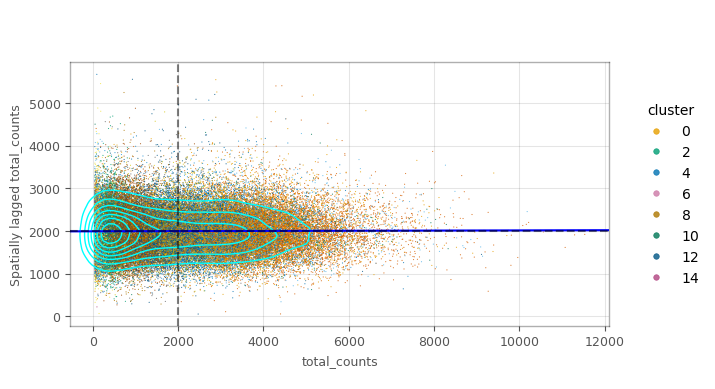

In [15]:
ax = vp.plt.moran_plot(andata_sub, feature="total_counts", color_by='cluster', alpha=0.8,s = 0.1)

In [16]:
_ = vp.spatial.local_moran(andata_sub, qc_features, graph_name=knn_graph)

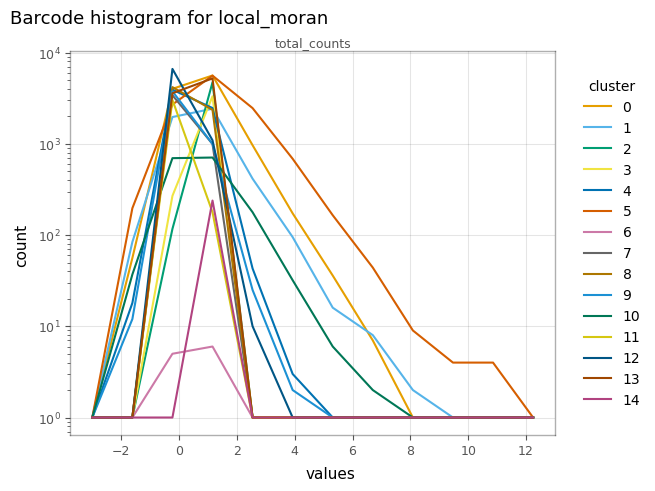

In [17]:
axs = vp.plt.plot_barcode_histogram(
    andata_sub,
    qc_features,
    obsm="local_moran",
    color_by='cluster',
    log=True,
    histtype='line',
    bins=10,
)

In [18]:
andata_sub

AnnData object with n_obs × n_vars = 80000 × 1500
    obs: 'n_genes_by_counts', 'total_counts', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'total_counts_MT', 'pct_counts_MT', 'log1p_total_counts_MT', 'cluster', 'lagged_total_counts'
    var: 'gene_ids', 'feature_types', 'genome', 'MT', 'n_cells_by_counts', 'total_counts', 'mean_counts', 'pct_dropout_by_counts', 'log1p_total_counts', 'log1p_mean_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'config', 'rank_genes_groups', 'lrfeatures', 'lr_summary', 'spatial'
    obsm: 'X_pca', 'spatial', 'spot_neighbours', 'spot_neigh_bcs', 'lr_scores', 'p_vals', '-log10(p_adjs)', 'lr_sig_scores', 'local_moran'
    layers: 'counts', 'log'
    obsp: 'distances', 'connectivities', 'knn_weights'

Gene expression level local morna-I analysis

In [19]:
hvg = andata_sub.var[andata_sub.var['highly_variable'].values].index
vp.spatial.moran(andata_sub, feature=hvg, dim='var', graph_name=knn_graph)

In [20]:
hvgs_moransI = andata_sub.uns['spatial']['moran'][knn_graph].loc[hvg, 'I']
andata_sub.var.loc[hvg, "moran"] = hvgs_moransI
andata_sub.var.loc[:, ["moran"]] = np.nan_to_num(andata_sub.var.loc[:, ["moran"]],0.0)
mat_names = np.ravel(pd.DataFrame(andata_sub.uns['rank_genes_groups']['names']).values)
marker_genes = mat_names[:20].tolist()
andata_sub.var['symbol'] = andata_sub.var['gene_ids'].values

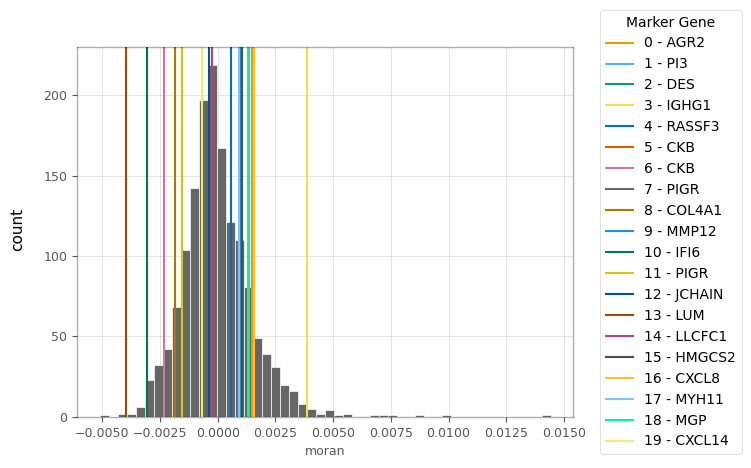

In [21]:
_ = vp.plt.plot_features_histogram(
    andata_sub,
    "moran",
    bins=50,
    log=False,
    histtype="bar",
    markers=marker_genes,
    show_symbol=False)

In [22]:
andata_sub

AnnData object with n_obs × n_vars = 80000 × 1500
    obs: 'n_genes_by_counts', 'total_counts', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'total_counts_MT', 'pct_counts_MT', 'log1p_total_counts_MT', 'cluster', 'lagged_total_counts'
    var: 'gene_ids', 'feature_types', 'genome', 'MT', 'n_cells_by_counts', 'total_counts', 'mean_counts', 'pct_dropout_by_counts', 'log1p_total_counts', 'log1p_mean_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std', 'moran', 'symbol'
    uns: 'config', 'rank_genes_groups', 'lrfeatures', 'lr_summary', 'spatial'
    obsm: 'X_pca', 'spatial', 'spot_neighbours', 'spot_neigh_bcs', 'lr_scores', 'p_vals', '-log10(p_adjs)', 'lr_sig_scores', 'local_moran'
    layers: 'counts', 'log'
    obsp: 'distances', 'connectivities', 'knn_weights'

In [23]:
andata_sub.var

,gene_ids,feature_types,genome,MT,n_cells_by_counts,total_counts,mean_counts,pct_dropout_by_counts,log1p_total_counts,log1p_mean_counts,highly_variable,highly_variable_rank,means,variances,variances_norm,mean,std,moran,symbol
HES4,ENSG00000188290,Gene Expression,GRCh38,False,3131,3307.0,0.024130,97.715449,8.104099,0.023843,True,1290.0,0.018792,0.018958,1.342425,0.018792,0.137687,-0.000619,ENSG00000188290
ISG15,ENSG00000187608,Gene Expression,GRCh38,False,12641,17144.0,0.125092,90.776426,9.749462,0.117865,True,1167.0,0.070754,0.068012,1.363739,0.070754,0.260791,-0.000187,ENSG00000187608
MXRA8,ENSG00000162576,Gene Expression,GRCh38,False,10515,12839.0,0.093680,92.327674,9.460320,0.089549,True,332.0,0.079095,0.089319,1.608070,0.079095,0.298863,0.000851,ENSG00000162576
ANKRD65,ENSG00000235098,Gene Expression,GRCh38,False,369,372.0,0.002714,99.730757,5.921578,0.002711,True,1021.0,0.002584,0.003097,1.389493,0.002584,0.055655,-0.000093,ENSG00000235098
MMP23B,ENSG00000189409,Gene Expression,GRCh38,False,1050,1081.0,0.007888,99.233862,6.986567,0.007857,True,781.0,0.007590,0.008903,1.440701,0.007590,0.094354,-0.000015,ENSG00000189409
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
L1CAM,ENSG00000198910,Gene Expression,GRCh38,False,1057,1295.0,0.009449,99.228754,7.167038,0.009405,True,304.0,0.007574,0.010028,1.626197,0.007574,0.100142,-0.000167,ENSG00000198910
DDX3Y,ENSG00000067048,Gene Expression,GRCh38,False,6168,6636.0,0.048420,95.499486,8.800415,0.047284,True,908.0,0.038510,0.039223,1.409182,0.038510,0.198049,-0.001220,ENSG00000067048
UTY,ENSG00000183878,Gene Expression,GRCh38,False,4323,4592.0,0.033506,96.845700,8.432289,0.032957,True,1264.0,0.026544,0.026445,1.346287,0.026544,0.162619,-0.000873,ENSG00000183878
KDM5D,ENSG00000012817,Gene Expression,GRCh38,False,7801,8665.0,0.063225,94.307958,9.067163,0.061306,True,883.0,0.049906,0.050260,1.414216,0.049906,0.224187,0.000384,ENSG00000012817


In [24]:
np.sort(andata_sub.var['moran'])[-2]

0.009814744660931386

In [25]:
andata_sub.var[andata_sub.var['moran']==np.sort(andata_sub.var['moran'])[-1]].index[0]

'CTRB1'

In [56]:
def plot_spatial_data_features(andata, gene_name, ax,fig, size = 2, set_xlabel_cbar = '',palette_name = "Reds", **kwargs):
    from matplotlib.colors import ListedColormap,Normalize
    from matplotlib.cm import ScalarMappable
    df = pd.DataFrame({
        'x': andata.obsm['spatial'][:, 0],
        'y': andata.obsm['spatial'][:, 1],
        'log10_count': np.ravel(andata.X[:,andata.var.index==gene_name].toarray())
    })
    palette = sns.color_palette(palette_name, as_cmap=True)
    listed_cmap = ListedColormap(palette(np.linspace(0, 1, 256)))
    
    norm = Normalize(vmin=df['log10_count'].min(), vmax=df['log10_count'].max())
    sc = ax.scatter(x=df['x'], y=df['y'], c=df['log10_count'], cmap=listed_cmap, norm=norm, s=size, **kwargs)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_xlabel('')
    ax.set_ylabel('')
    
    cbar = fig.colorbar(ScalarMappable(norm=norm, cmap=listed_cmap), ax=ax)
    cbar.ax.set_xlabel(set_xlabel_cbar, labelpad=10)
    cbar.ax.xaxis.set_label_position('top')
    cbar.ax.xaxis.label.set_size(10)  # Reduce label font size
    cbar.ax.tick_params(labelsize=8) 
    return sc

In [27]:
len(andata_sub.obsm['spatial'][:, 1])

80000

In [28]:
np.ravel(andata_sub.X[:,andata_sub.var.index=='LUM'].toarray())

array([0.       , 2.2892349, 0.       , ..., 0.       , 0.       ,
       0.       ], dtype=float32)

In [29]:
andata_sub.var[andata_sub.var['moran']==np.sort(andata_sub.var['moran'])[1]].index[0]

'LUM'

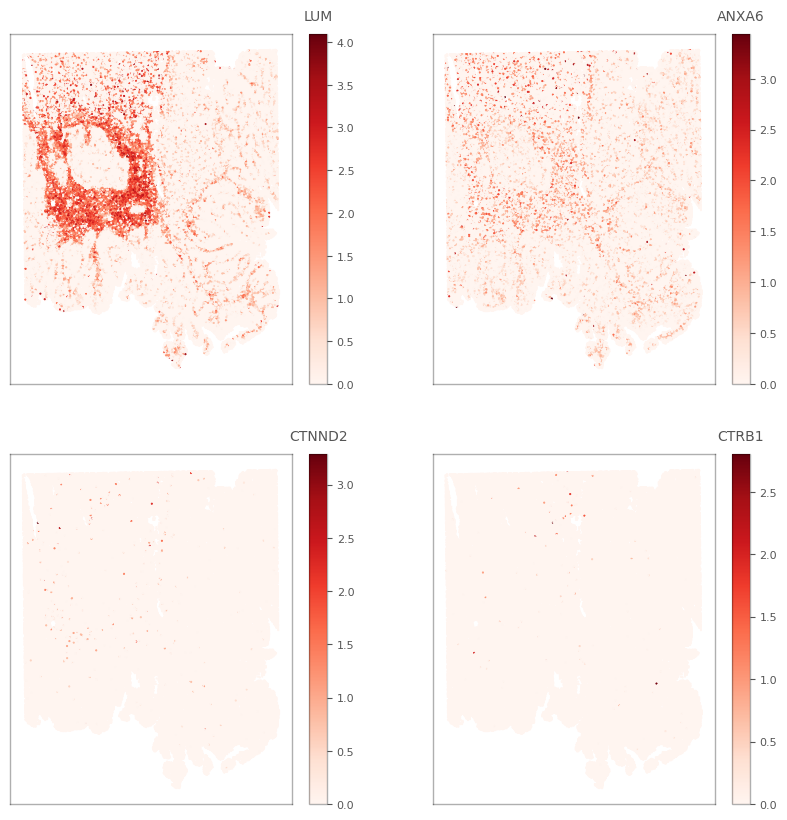

In [65]:
fig, ax = plt.subplots(2,2, figsize=(10, 10))
ax = ax.ravel()
plot_spatial_data_features(andata = andata_sub,gene_name =  'LUM', fig = fig , ax = ax[0] ,set_xlabel_cbar = 'LUM',size = 1)
plot_spatial_data_features(andata = andata_sub,gene_name =  andata_sub.var[andata_sub.var['moran']==np.sort(andata_sub.var['moran'])[2]].index[0], fig = fig , ax = ax[1] ,set_xlabel_cbar = andata_sub.var[andata_sub.var['moran']==np.sort(andata_sub.var['moran'])[2]].index[0],size = 1)
plot_spatial_data_features(andata = andata_sub,gene_name =  andata_sub.var[andata_sub.var['moran']==np.sort(andata_sub.var['moran'])[-3]].index[0], fig = fig , ax = ax[2] ,set_xlabel_cbar = andata_sub.var[andata_sub.var['moran']==np.sort(andata_sub.var['moran'])[-2]].index[0],size = 1)
plot_spatial_data_features(andata = andata_sub,gene_name =  andata_sub.var[andata_sub.var['moran']==np.sort(andata_sub.var['moran'])[-4]].index[0], fig = fig , ax = ax[3] ,set_xlabel_cbar = andata_sub.var[andata_sub.var['moran']==np.sort(andata_sub.var['moran'])[-1]].index[0],size = 1)

In [66]:
cluster_num = len(np.unique(andata_sub.obs['cluster'].values))
_ = vp.spatial.local_moran(andata_sub, marker_genes, graph_name=knn_graph)
marker_genes_symbols = andata_sub.var.loc[marker_genes, "symbol"].tolist()

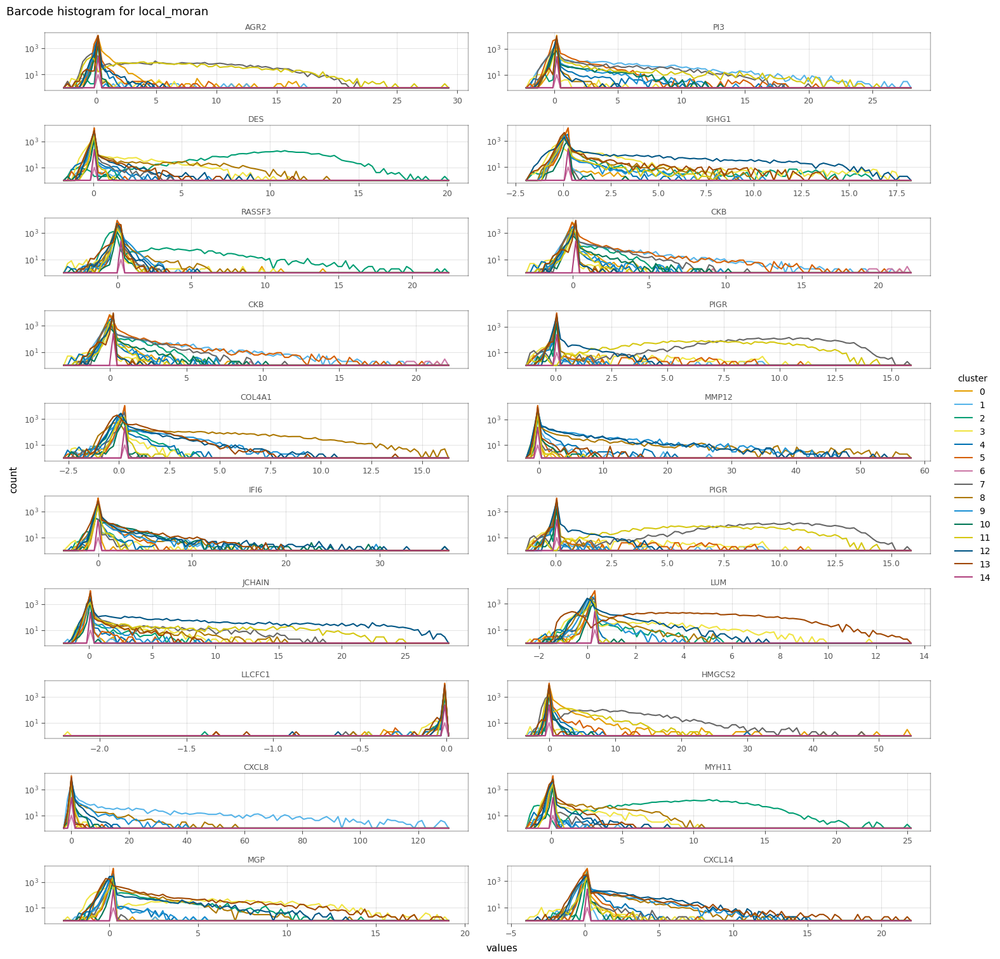

In [67]:
_ = vp.plt.plot_barcode_histogram(
        andata_sub,
        marker_genes,
        color_by='cluster',
        obsm='local_moran',
        histtype='line',
        figsize=(15,15),
        subplot_kwargs=dict(layout='constrained'),
        label=marker_genes,
        ncol=2
    )

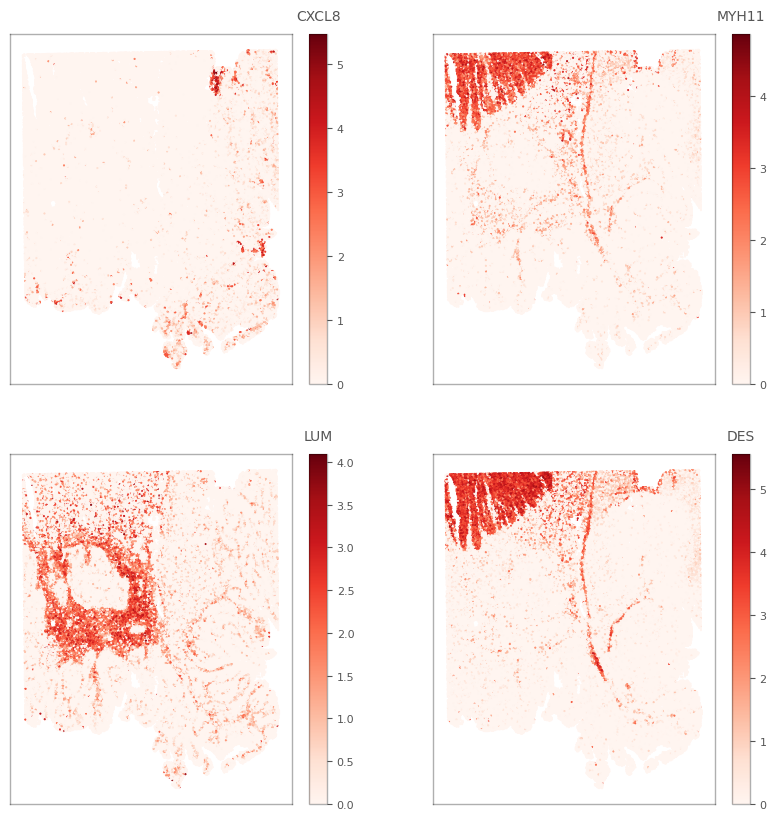

In [32]:
fig, ax = plt.subplots(2,2, figsize=(10, 10))
ax = ax.ravel()
plot_spatial_data_features(andata = andata_sub,gene_name =  'IGHG1', fig = fig , ax = ax[0] ,set_xlabel_cbar = 'CXCL8',size = 1)
plot_spatial_data_features(andata = andata_sub,gene_name =  'MYH11', fig = fig , ax = ax[1] ,set_xlabel_cbar = 'MYH11',size = 1)
plot_spatial_data_features(andata = andata_sub,gene_name =  'LUM', fig = fig , ax = ax[2] ,set_xlabel_cbar = 'LUM',size = 1)
plot_spatial_data_features(andata = andata_sub,gene_name =  'DES', fig = fig , ax = ax[3] ,set_xlabel_cbar = 'DES',size = 1)

In [37]:
selected_genes = ['LUM','MYH11','IGHG1','PIGR']

In [42]:
_ = vp.spatial.local_moran(andata_sub,feature = selected_genes, graph_name=knn_graph,key_added = 'local_moran_selected_genes')

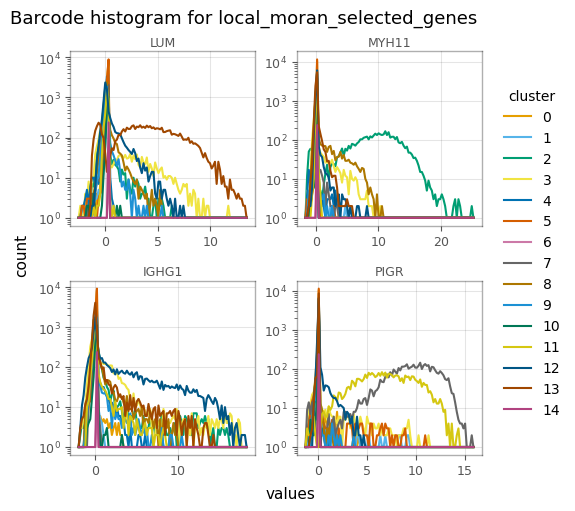

In [44]:
_ = vp.plt.plot_barcode_histogram(
        andata_sub,
        selected_genes,
        color_by='cluster',
        obsm='local_moran_selected_genes',
        histtype='line',
        figsize=(5,5),
        subplot_kwargs=dict(layout='constrained'),
        label=selected_genes,
        ncol=2
    )

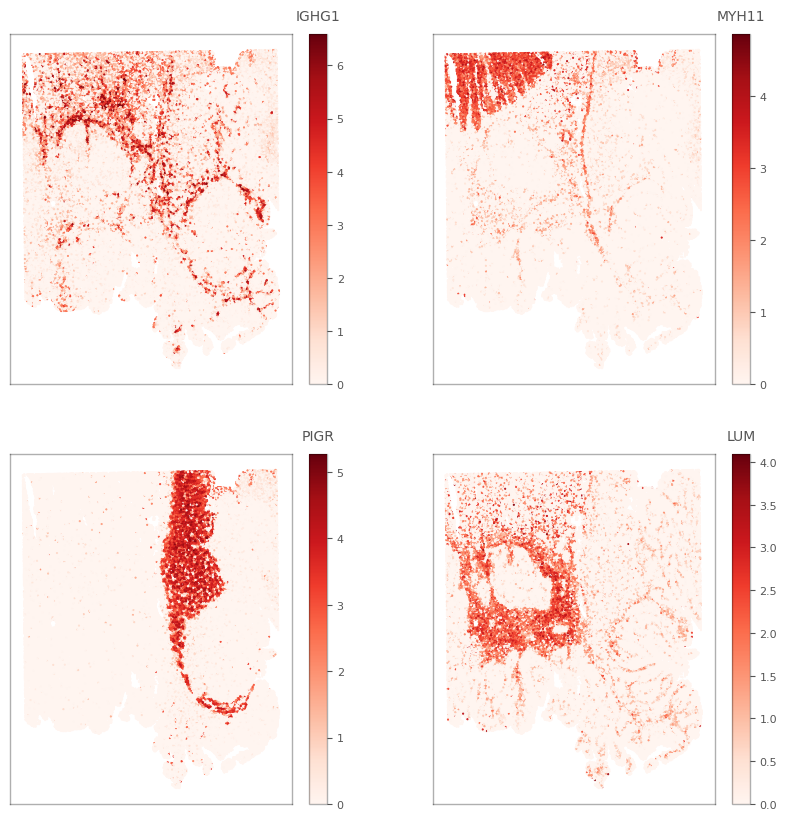

In [35]:
fig, ax = plt.subplots(2,2, figsize=(10, 10))
ax = ax.ravel()
plot_spatial_data_features(andata = andata_sub,gene_name =  'IGHG1', fig = fig , ax = ax[0] ,set_xlabel_cbar = 'IGHG1',size = 1)
plot_spatial_data_features(andata = andata_sub,gene_name =  'PIGR', fig = fig , ax = ax[2] ,set_xlabel_cbar = 'PIGR',size = 1)
plot_spatial_data_features(andata = andata_sub,gene_name =  'MYH11', fig = fig , ax = ax[1] ,set_xlabel_cbar = 'MYH11',size = 1)
plot_spatial_data_features(andata = andata_sub,gene_name =  'LUM', fig = fig , ax = ax[3] ,set_xlabel_cbar = 'LUM',size = 1)

In [45]:
andata_sub

AnnData object with n_obs × n_vars = 80000 × 1500
    obs: 'n_genes_by_counts', 'total_counts', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'total_counts_MT', 'pct_counts_MT', 'log1p_total_counts_MT', 'cluster', 'lagged_total_counts'
    var: 'gene_ids', 'feature_types', 'genome', 'MT', 'n_cells_by_counts', 'total_counts', 'mean_counts', 'pct_dropout_by_counts', 'log1p_total_counts', 'log1p_mean_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std', 'moran', 'symbol'
    uns: 'config', 'rank_genes_groups', 'lrfeatures', 'lr_summary', 'spatial'
    obsm: 'X_pca', 'spatial', 'spot_neighbours', 'spot_neigh_bcs', 'lr_scores', 'p_vals', '-log10(p_adjs)', 'lr_sig_scores', 'local_moran', 'local_moran_selected_genes'
    layers: 'counts', 'log'
    obsp: 'distances', 'connectivities', 'knn_weights'

In [55]:
andata_sub.uns['lrfeatures']

,nonzero-median,zero-prop,median_rank,prop_rank,mean_rank,L_0.5,L_0.75,L_0.85,L_0.9,L_0.95,...,R_0.85,R_0.9,R_0.95,R_0.97,R_0.98,R_0.99,R_0.995,R_0.9975,R_0.999,R_1.0
NTRK3_PTPRS,1.0,0.986063,6,11,8.5,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,5.0
NLGN2_NRXN1,1.0,0.980909,3,20,11.5,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,2.0,6.0
NLGN2_NRXN3,1.0,0.978759,4,23,13.5,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,3.0
OSM_LIFR,1.0,0.980174,7,21,14.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,3.0
MMRN2_CLEC14A,1.0,0.97754,9,26,17.5,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,1.0,1.0,2.0,2.0,5.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MUC2_AGR2,2.5,0.867053,183,164,173.5,0.0,0.0,0.0,0.0,3.0,...,1.0,1.0,2.0,3.0,5.0,7.0,8.0,10.0,13.0,45.0
COL4A1_CD93,1.5,0.854924,180,172,176.0,0.0,0.0,1.0,2.0,4.0,...,0.0,0.0,1.0,1.0,1.0,2.0,2.0,3.0,3.0,8.0
MMP12_PLAUR,1.5,0.856365,182,171,176.5,0.0,0.0,0.0,1.0,3.0,...,1.0,1.0,1.0,2.0,2.0,3.0,4.0,5.0,7.0,16.0
COL4A1_ITGA1,1.5,0.822392,179,180,179.5,0.0,0.0,1.0,2.0,4.0,...,0.0,1.0,1.0,1.0,2.0,2.0,3.0,3.0,4.0,11.0


In [48]:
andata_sub.uns['lr_summary']

,n_spots,n_spots_sig,n_spots_sig_pval
MCAM_MCAM,12299,10103,10750
MUC2_AGR2,8426,8371,8386
COL4A1_ITGA1,9004,7496,8031
PTPRM_PTPRM,6339,5926,6308
CCN2_LRP1,7308,5720,6179
...,...,...,...
ANGPTL1_TEK,26,26,26
IL16_KCNJ15,26,26,26
VWF_ITGA2B,24,24,24
NTRK3_PTPRS,21,21,21


In [78]:
def plot_spatial_data_features_bivar(andata, gene_name1,gene_name2, ax,fig, size = 2, set_xlabel_cbar = '',palette_name1 = "Reds",palette_name2 = "Blues", **kwargs):
    from matplotlib.colors import ListedColormap,Normalize
    from matplotlib.cm import ScalarMappable
    df = pd.DataFrame({
        'x': andata.obsm['spatial'][:, 0],
        'y': andata.obsm['spatial'][:, 1],
        'log10_count_g1': np.ravel(andata.X[:,andata.var.index==gene_name1].toarray()),
        'log10_count_g2': np.ravel(andata.X[:,andata.var.index==gene_name2].toarray())
    })
    palette1 = sns.color_palette(palette_name1, as_cmap=True)
    palette2 = sns.color_palette(palette_name2, as_cmap=True)
    listed_cmap1 = ListedColormap(palette1(np.linspace(0, 1, 256)))
    listed_cmap2 = ListedColormap(palette2(np.linspace(0, 1, 256)))
    
    norm = Normalize(vmin=df['log10_count_g1'].min(), vmax=df['log10_count_g1'].max())
    sc = ax.scatter(x=df['x'], y=df['y'], c=df['log10_count_g1'], cmap=listed_cmap1, norm=norm, s=size, **kwargs)
    norm = Normalize(vmin=df['log10_count_g2'].min(), vmax=df['log10_count_g2'].max())
    sc = ax.scatter(x=df['x'], y=df['y'], c=df['log10_count_g2'], cmap=listed_cmap2, norm=norm, s=size,alpha = 0.1)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_xlabel('')
    ax.set_ylabel('')

    return sc

(0.0, 1.0, 0.0, 1.0)

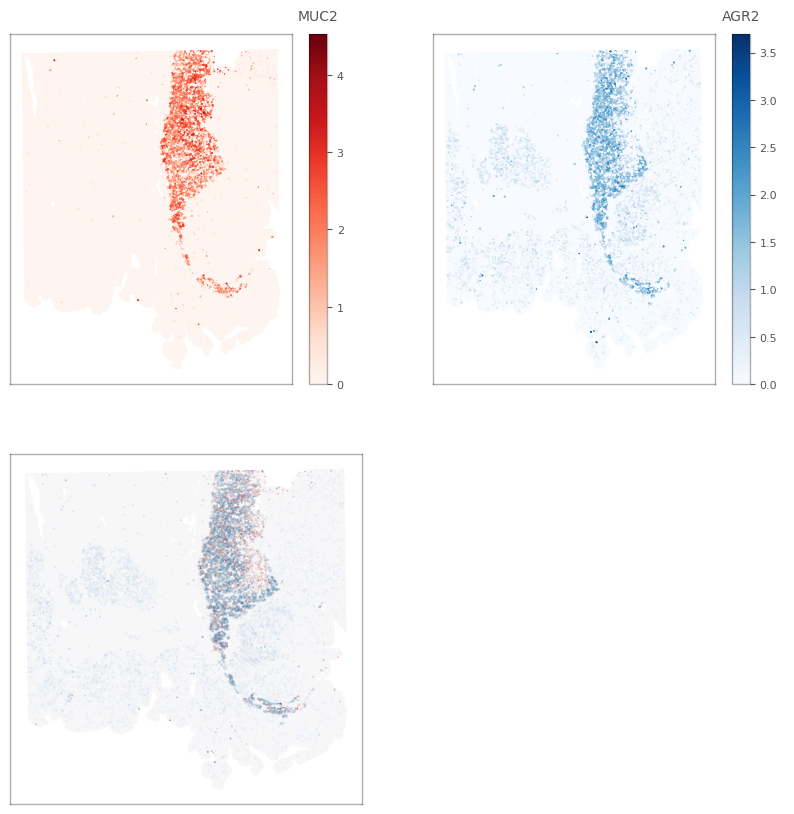

In [77]:
fig, ax = plt.subplots(2,2, figsize=(10, 10))
ax = ax.ravel()
plot_spatial_data_features(andata = andata_sub,gene_name =  'MUC2', fig = fig , ax = ax[0] ,set_xlabel_cbar = 'MUC2',size = 1,palette_name = "Reds")
plot_spatial_data_features(andata = andata_sub,gene_name =  'AGR2', fig = fig , ax = ax[1] ,set_xlabel_cbar = 'AGR2',size = 1,palette_name = "Blues")
plot_spatial_data_features_bivar(andata = andata_sub,gene_name1 =  'MUC2',gene_name2 = 'AGR2',  fig = fig , ax = ax[2] ,set_xlabel_cbar = 'MUC2',size = 1)
ax[3].axis('off')